<a href="https://colab.research.google.com/github/caluq/elec4630/blob/main/src/Dlib_Exercise.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#ELEC4630 Exercise on Face Recognition
First check if the dlib library is installed

In [ ]:
!pip install dlib


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


Get some sample images from gitHub and place them a folder called 'images'.

In [1]:
# First store some sample images in the folder 'images'
!mkdir -p images
!cd images; wget -nc https://github.com/caluq/elec4630/blob/f713b7e2d0656f8f3a6dd1dac1c4792077b523d4/images/image_0001.jpg
#!cd images; wget -nc https://raw.githubusercontent.com/lovellbrian/ELEC4630/master/Images/biden.jpg
!cd images; wget -nc https://github.com/caluq/elec4630/blob/5559fccf201435ab6984eb50837d30117ba83676/images/image_0002.jpg

--2022-05-30 05:33:27--  https://github.com/caluq/elec4630/blob/f713b7e2d0656f8f3a6dd1dac1c4792077b523d4/images/image_0001.jpg
Resolving github.com (github.com)... 140.82.114.3
Connecting to github.com (github.com)|140.82.114.3|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [text/html]
Saving to: ‘image_0001.jpg’

image_0001.jpg          [ <=>                ] 124.31K  --.-KB/s    in 0.04s   

2022-05-30 05:33:28 (3.26 MB/s) - ‘image_0001.jpg’ saved [127295]

--2022-05-30 05:33:28--  https://github.com/caluq/elec4630/blob/5559fccf201435ab6984eb50837d30117ba83676/images/image_0002.jpg
Resolving github.com (github.com)... 140.82.113.3
Connecting to github.com (github.com)|140.82.113.3|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [text/html]
Saving to: ‘image_0002.jpg’

image_0002.jpg          [ <=>                ] 128.68K  --.-KB/s    in 0.04s   

2022-05-30 05:33:28 (3.36 MB/s) - ‘image_0002.jpg’ saved [131

Now install the face recognition module from Dlib

In [2]:
!pip3 install face_recognition

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 100.1 MB 26 kB/s 
  Created wheel for face-recognition-models: filename=face_recognition_models-0.3.0-py2.py3-none-any.whl size=100566186 sha256=779d94efecfd52af713aedb8cc9a1b6fdf9a7d0c5a3ab273e8808b512439392f
  Stored in directory: /root/.cache/pip/wheels/d6/81/3c/884bcd5e1c120ff548d57c2ecc9ebf3281c9a6f7c0e7e7947a
Successfully built face-recognition-models


Now lets find some faces!

In [19]:

print("Hello World")
import os
cwd = os.getcwd()
print(cwd)
print(os.listdir("./images"))
    

Hello World
/content
['image_0001.jpg', 'image_0002.jpg']


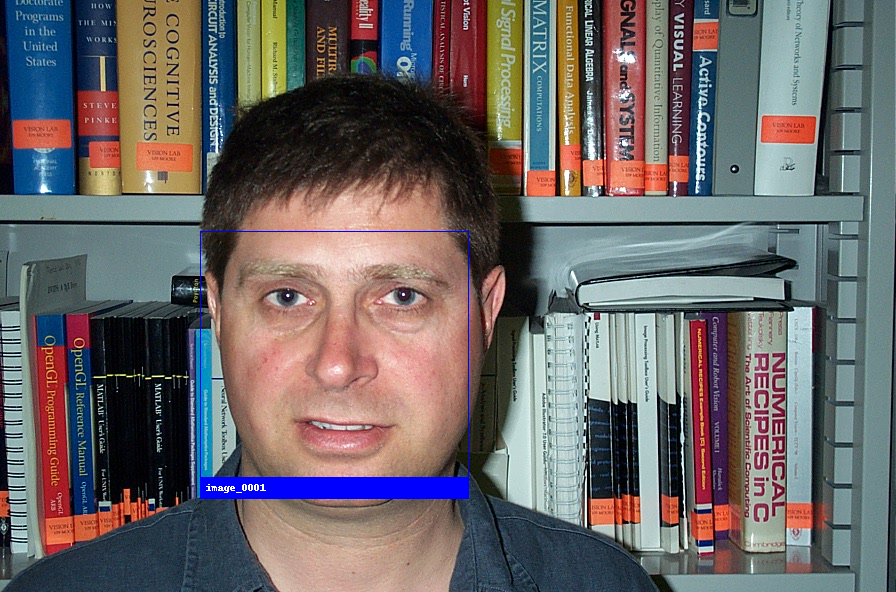

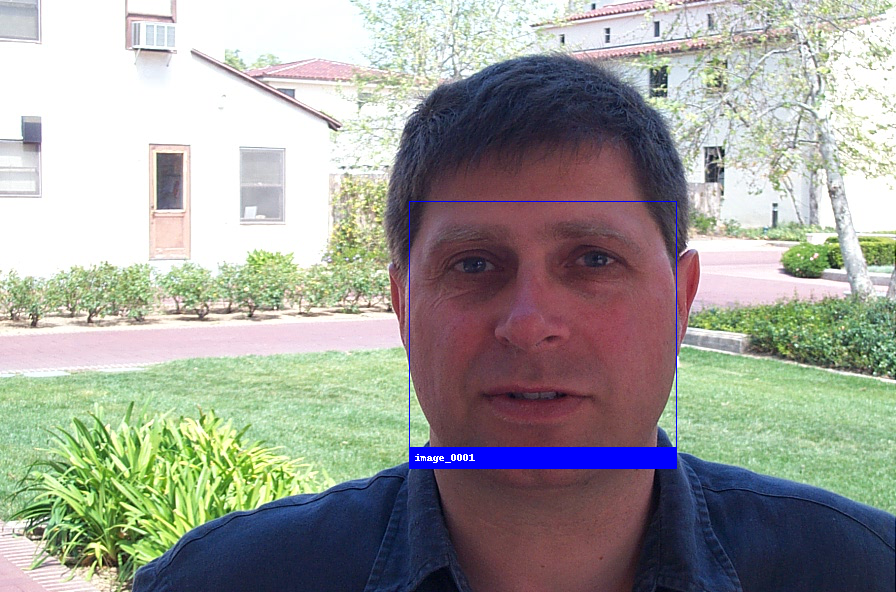

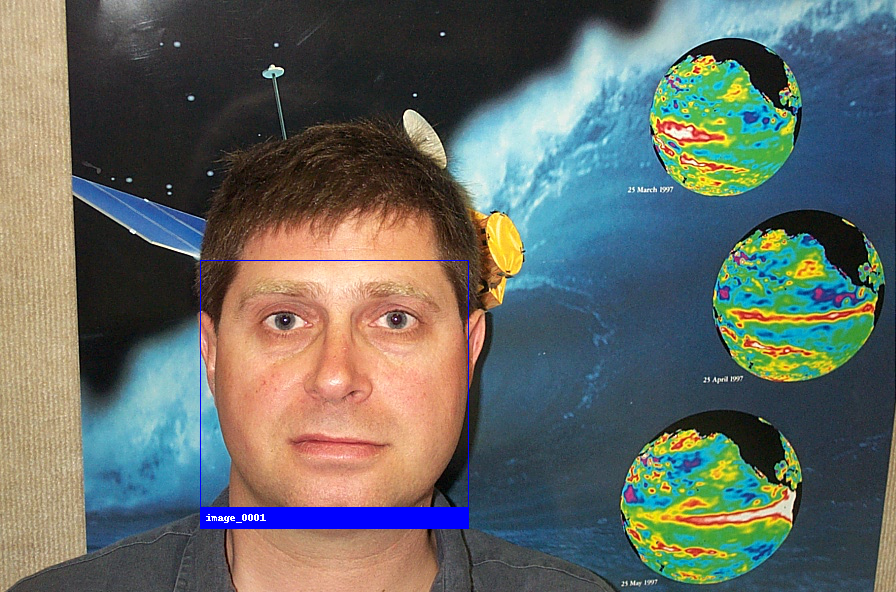

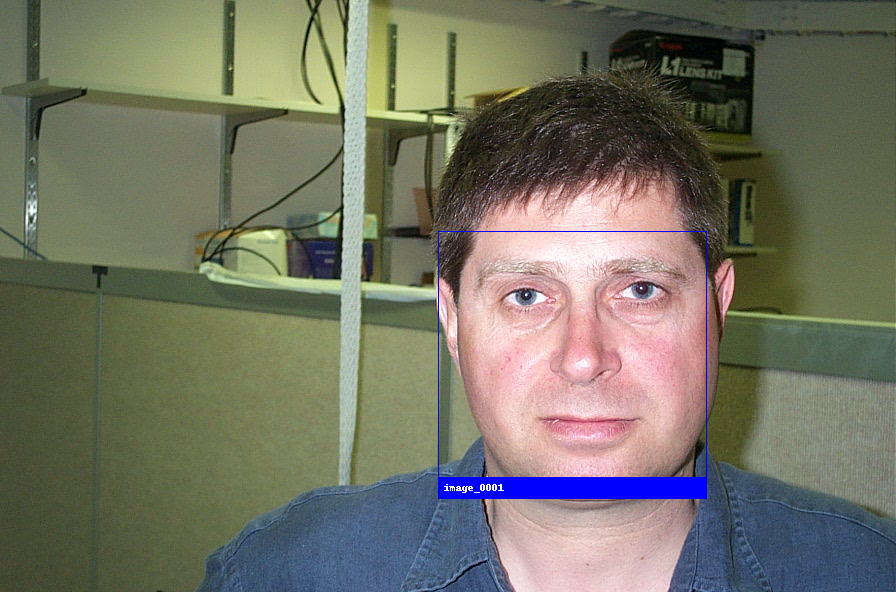

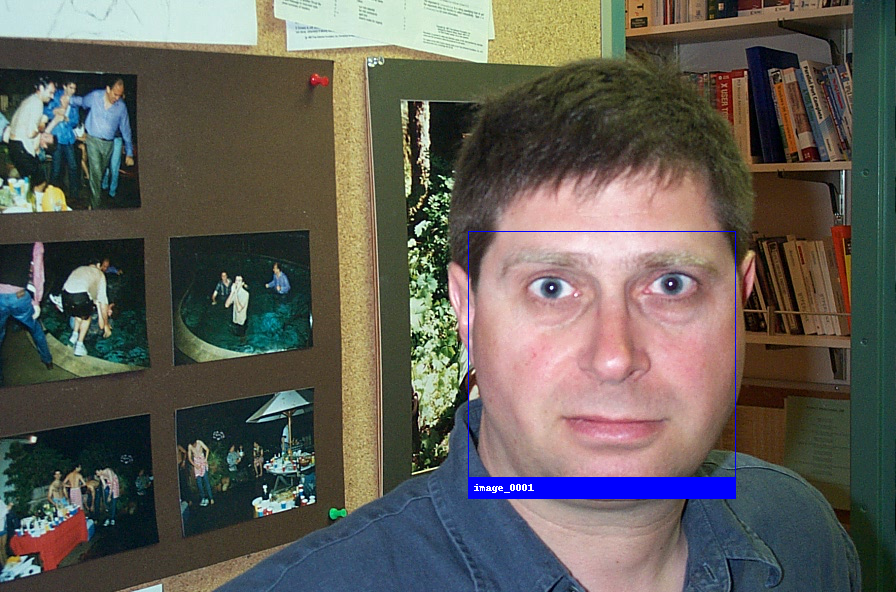

...

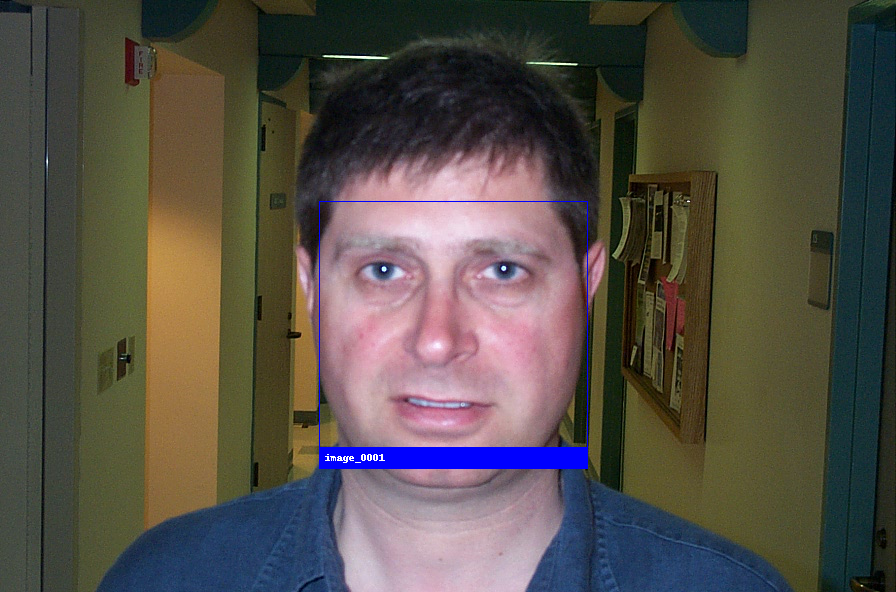

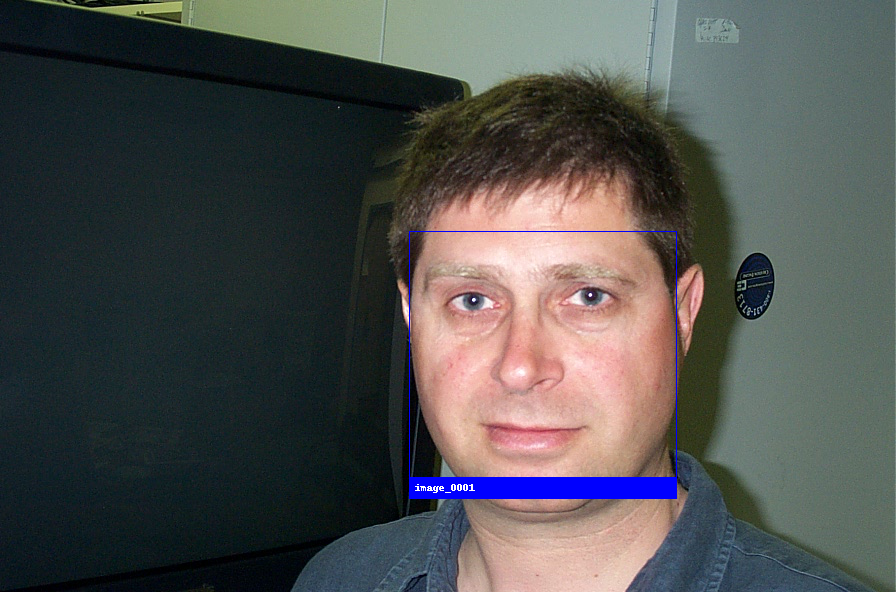

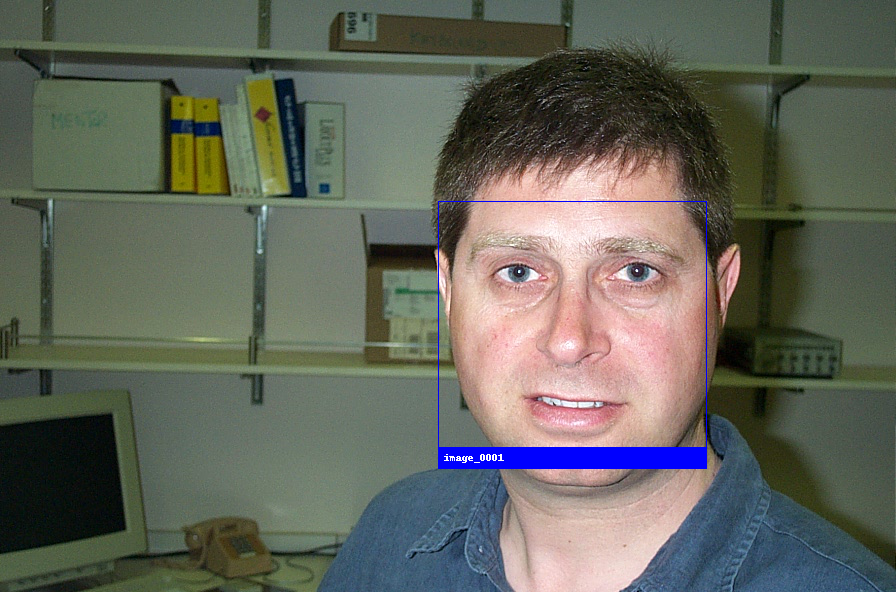

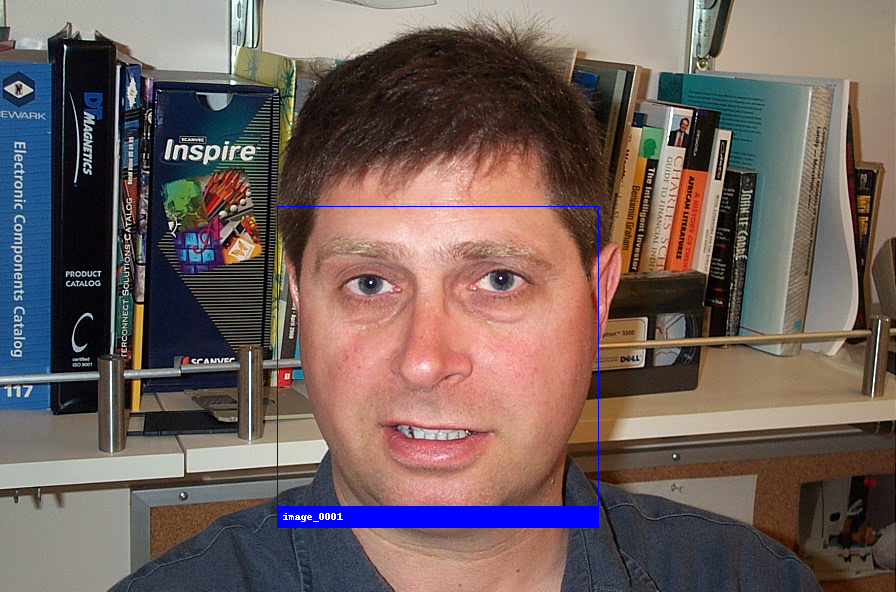

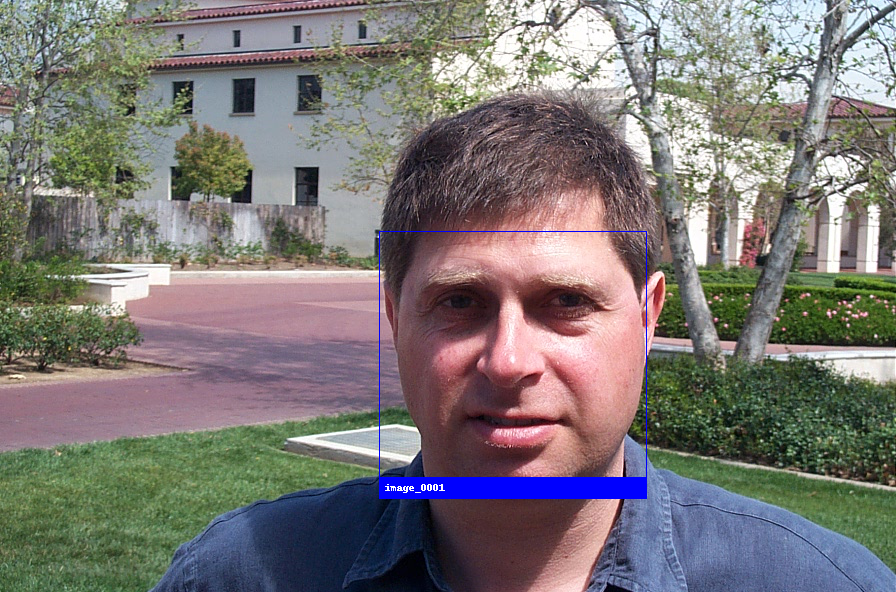

In [34]:
import face_recognition
from PIL import Image, ImageDraw
import numpy as np



# This is an example of running face recognition on a single image
# and drawing a box around each person that was identified.

# Load a sample picture and learn how to recognize it.
prefix = "./images/" 
image_list = os.listdir(prefix)
image_list.sort() 

image_0001 = face_recognition.load_image_file(prefix + image_list[1])
image_0001_face_encoding = face_recognition.face_encodings(image_0001)[0]

# Load a second sample picture and learn how to recognize it.
#biden_image = face_recognition.load_image_file("images/biden.jpg")
#biden_face_encoding = face_recognition.face_encodings(biden_image)[0]

# Create arrays of known face encodings and their names
known_face_encodings = [
    image_0001_face_encoding
]
known_face_names = [
    "image_0001"
]

unknown_images = [None] * len(image_list)
for i in range(2, len(image_list)):
  unknown_images[i] = face_recognition.load_image_file(prefix + image_list[i])


for i in range(2, len(image_list)):

  unknown_image = unknown_images[i]

  # Find all the faces and face encodings in the unknown image
  face_locations = face_recognition.face_locations(unknown_image)
  face_encodings = face_recognition.face_encodings(unknown_image, face_locations)

  # Convert the image to a PIL-format image so that we can draw on top of it with the Pillow library
  # See http://pillow.readthedocs.io/ for more about PIL/Pillow
  pil_image = Image.fromarray(unknown_image)
  # Create a Pillow ImageDraw Draw instance to draw with
  draw = ImageDraw.Draw(pil_image)

  # Loop through each face found in the unknown image
  for (top, right, bottom, left), face_encoding in zip(face_locations, face_encodings):
      # See if the face is a match for the known face(s)
      matches = face_recognition.compare_faces(known_face_encodings, face_encoding)

      name = "Unknown"

      # If a match was found in known_face_encodings, just use the first one.
      # if True in matches:
      #     first_match_index = matches.index(True)
      #     name = known_face_names[first_match_index]

      # Or instead, use the known face with the smallest distance to the new face
      face_distances = face_recognition.face_distance(known_face_encodings, face_encoding)
      best_match_index = np.argmin(face_distances)
      if matches[best_match_index]:
          name = known_face_names[best_match_index]

      # Draw a box around the face using the Pillow module
      draw.rectangle(((left, top), (right, bottom)), outline=(0, 0, 255))

      # Draw a label with a name below the face
      text_width, text_height = draw.textsize(name)
      draw.rectangle(((left, bottom - text_height - 10), (right, bottom)), fill=(0, 0, 255), outline=(0, 0, 255))
      draw.text((left + 6, bottom - text_height - 5), name, fill=(255, 255, 255, 255))


  # Remove the drawing library from memory as per the Pillow docs
  del draw

  # Display the resulting image
  # pil_image.show()  does not work in iPython
  display(pil_image)

  # You can also save a copy of the new image to disk if you want by uncommenting this line
  # pil_image.save("image_with_boxes.jpg")